In [1]:
from tensorflow.keras.models import load_model
import cv2
import numpy as np
from matplotlib import pyplot as plt
import random
import tensorflow as tf
import os

2023-12-21 13:04:42.621633: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-21 13:04:42.621688: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-21 13:04:42.621730: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-21 13:04:42.631376: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
loaded_model = load_model("models/checkpoints_new/09.h5")
alp_model = load_model("model_aug.h5")

2023-12-21 13:04:46.410064: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1886] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 4121 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3060 Laptop GPU, pci bus id: 0000:01:00.0, compute capability: 8.6


In [3]:
# funsgi 
def opencv_resize(image, ratio):
    width = int(image.shape[1] * ratio)
    height = int(image.shape[0] * ratio)
    dim = (width, height)
    return cv2.resize(image, dim, interpolation = cv2.INTER_AREA)

# approximate the contour by a more primitive polygon shape
def approximate_contour(contour):
    peri = cv2.arcLength(contour, True)
    return cv2.approxPolyDP(contour, 0.032 * peri, True)


def get_contour(contours):
    # loop over the contours
    for c in contours:
        approx = approximate_contour(c)
        # if our approximated contour has four points, we can assume it is receipt's rectangle
        # and the size is not too big
        if len(approx) == 4 and cv2.contourArea(c) < 700000 and cv2.contourArea(c) > 10000:
            return approx

def contour_to_rect(contour):
    pts = contour.reshape(4, 2)
    rect = np.zeros((4, 2), dtype = "float32")
    # top-left point has the smallest sum
    # bottom-right has the largest sum
    s = pts.sum(axis = 1)
    rect[0] = pts[np.argmin(s)]
    rect[2] = pts[np.argmax(s)]
    # compute the difference between the points:
    # the top-right will have the minumum difference 
    # the bottom-left will have the maximum difference
    diff = np.diff(pts, axis = 1)
    rect[1] = pts[np.argmin(diff)]
    rect[3] = pts[np.argmax(diff)]
    return rect

def find_roi(img,thres = "otsu", orientation='up'):
    image = img.copy()
    resize_ratio = 4000 / image.shape[0]
    image = opencv_resize(image, resize_ratio)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # hilangkan noise
    blurred = cv2.GaussianBlur(gray, (51, 51), 0)
    if thres == "otsu":
        thresh = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    elif thres == "binary":
        thresh = cv2.threshold(blurred, 160, 255, cv2.THRESH_BINARY_INV)[1]
    elif thres == "binary2":
        thresh = cv2.threshold(blurred, 130, 255, cv2.THRESH_BINARY_INV)[1]
    # plt.imshow (thresh, cmap='gray')
    # plt.show()
    edged = cv2.Canny(thresh, 100, 200, apertureSize=3)
    contours, _ = cv2.findContours(edged, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    largest_contours = sorted(contours, key = cv2.contourArea, reverse = True)[:10]
    receipt_contour = get_contour(largest_contours)
    if receipt_contour is None:
        return None, None, None
    rect = contour_to_rect(receipt_contour)
    pts1 = np.float32(rect)
    # pts2 = np.float32([[375,25],[375,525],[0,525],[0,25]])
    # pts2 = np.float32([[0,525],[0,25],[375,25],[375,525]])
    # pts2 = np.float32([[100, 400], [475, 400], [475, 900], [100, 900]])
    # pts2 = np.float32([[375, 525], [0, 525], [0, 25], [375, 25]])
    if orientation == 'up':
        pts2 = np.float32([[0, 450], [375, 450], [375, 950], [0, 950]])
    elif orientation == 'down':
        pts2 = np.float32([[375, 950], [0, 950], [0, 450], [375, 450]])
    elif orientation == 'left':
        pts2 = np.float32([[450, 375], [950, 375], [950, 0], [450, 0]])
    elif orientation == 'right':
        pts2 = np.float32([[0, 950], [0, 450], [375, 450], [375, 950]])
    elif orientation == 'right-flip':
        pts2 = np.float32([[0, 450], [0, 950], [375, 950], [375, 450]])
        # pts2 = np.float32([[375, 450], [375, 950], [0, 950], [0, 450]])
    elif orientation == 'right2':
        pts2 = np.float32([[375, 450], [375, 950], [0, 950], [0, 450]])


        
    M = cv2.getPerspectiveTransform(pts1,pts2)
    dst = cv2.warpPerspective(image,M,(2100,1300))
    text_area = dst
    gray_text = cv2.cvtColor(text_area, cv2.COLOR_BGR2GRAY)

    # show before and after perspective transform
    plt.figure(figsize=(20, 10))
    plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)), plt.title('Before')
    plt.subplot(122), plt.imshow(cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)), plt.title('After')
    plt.show()
    # thresh = cv2.threshold(gray_text, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    # gray_text = cv2.GaussianBlur(gray_text, (3, 3), 0)
    # thresh = cv2.adaptiveThreshold(gray_text, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 23, 7)
    # thresh = 255 - thresh
    # opening = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, np.ones((3,3), np.uint8), iterations=1)

    header = gray_text[0:300, 400:2050]
    header_thres = cv2.threshold(header, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    header_close = cv2.morphologyEx(header_thres, cv2.MORPH_OPEN, np.ones((3,3), np.uint8), iterations=1)
    header_close = 255 - header_close
    body = gray_text[420:920, 550:1700]
    body_thres = cv2.threshold(body, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    body_close = cv2.morphologyEx(body_thres, cv2.MORPH_OPEN, np.ones((3,3), np.uint8), iterations=1)
    body_close = 255 - body_close
    footer = gray_text[1100:1350, 1300:2050]
    footer_thres = cv2.threshold(footer, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]
    footer_close = cv2.morphologyEx(footer_thres, cv2.MORPH_OPEN, np.ones((3,3), np.uint8), iterations=3)
    footer_close = 255 - footer_close

    plt.figure(figsize=(20, 10))
    plt.subplot(131), plt.imshow(header, cmap='gray'), plt.title('Header')
    plt.subplot(132), plt.imshow(body, cmap='gray'), plt.title('Body')
    plt.subplot(133), plt.imshow(footer, cmap='gray'), plt.title('Footer')
    plt.show()
    return header_close, body_close, footer_close



Invalid SOS parameters for sequential JPEG


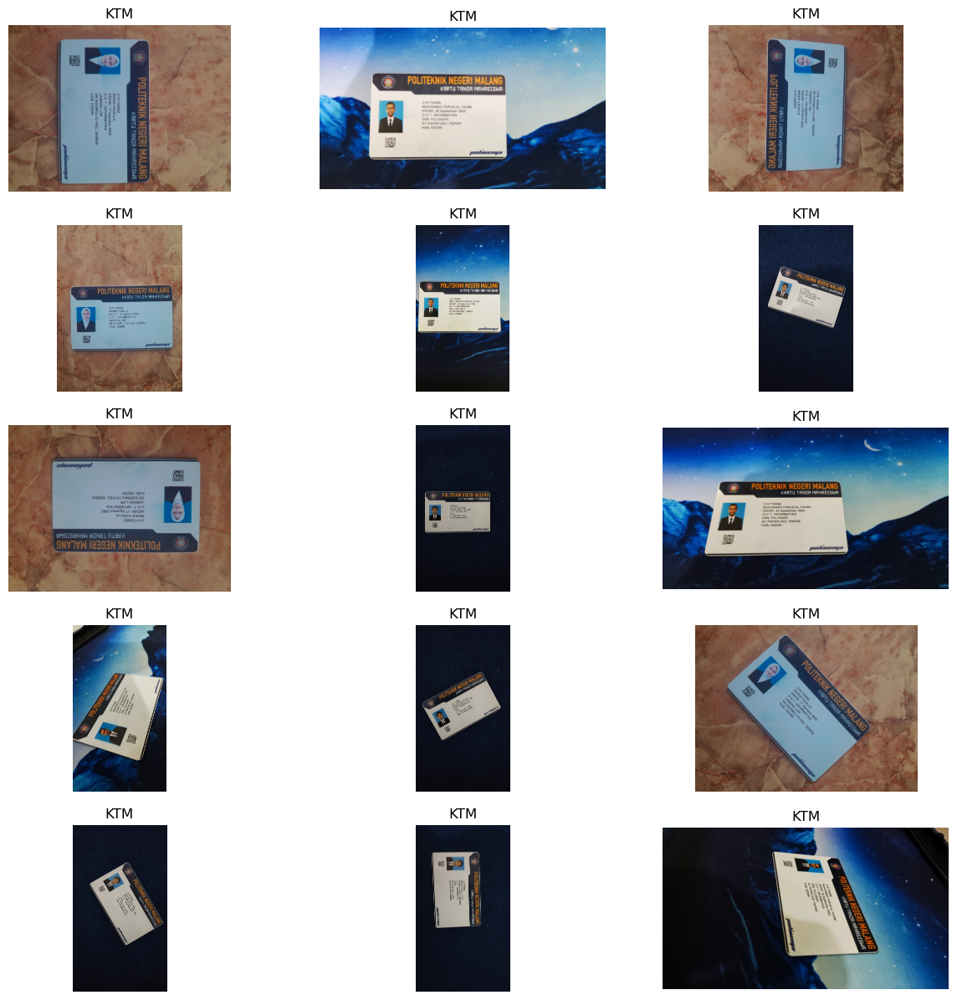

In [4]:
ktms = []

for filename in os.listdir("dataset/kel8"):
    img = cv2.imread("dataset/kel8/" + filename)
    ktms.append(img)

# sum of ktms is 15
fig = plt.figure(figsize=(15, 15))
for i in range(15):
    img = ktms[i]
    # show original image
    ax = fig.add_subplot(5, 3, i + 1)
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.set_title("KTM")
    ax.axis("off")
plt.show()

In [7]:
classAlp = []
classAlp.extend([chr(i) for i in range(ord('A'), ord('Z')+1)])
class_names = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', 'a', 'b', 'c', 'd', 'e', 'f', 'g', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'v', 'w', 'x', 'y', 'z']
params = [['otsu', 'right'], ['binary', 'up'], ['otsu', 'right-flip'], ['otsu', 'up'], ['binary', 'up'], ['binary', 'up'], ['otsu', 'down'], ['binary2', 'up'], ['binary', 'up'], 
          ['otsu', 'right2'], ['binary2','up'], ['binary2', 'right'], ['binary2', 'right'], ['binary2', 'right'], ['binary2', 'right']]

def get_chars_header(img):
    contours, _ = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    # image_with_contours = cv2.drawContours(text_area.copy(), contours, -1, (0,255,0), -1)
    roi_copy =  cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    # add padding to the image
    roi_copy = cv2.copyMakeBorder(roi_copy,10,10,10,10,cv2.BORDER_CONSTANT,value=[255,255,255])
    img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    for contour in contours:
        if cv2.contourArea(contour) > 100:
            [x,y,w,h] = cv2.boundingRect(contour)
            if h > 50 and h < 200:
                char = img[y:y+h, x:x+w]
                ratio_size = 110 / h
                char = opencv_resize(char, ratio_size)
                if char.shape[1] > 128:
                    char = char[:,0:128]
                if char.shape[0] > 128:
                    char = char[0:128,:]
                if char.shape[1] < 128:
                    char = cv2.copyMakeBorder(char,0,0,0,128-char.shape[1],cv2.BORDER_CONSTANT,value=[0,0,0])
                if char.shape[0] < 128:
                    char = cv2.copyMakeBorder(char,0,128-char.shape[0],0,0,cv2.BORDER_CONSTANT,value=[0,0,0])
                # check if black area is more than 50%
                black_area = np.sum(char == 0) / (char.shape[0] * char.shape[1])
                if black_area > 0.07:
                    #blur
                    char = cv2.GaussianBlur(char, (3, 3), 0)
                    resize = tf.image.resize(char,(128,128))
                    yhat = alp_model.predict(tf.expand_dims(resize, axis=0))
                    acc_pred = [f"{round(float(yhat[i][np.argmax(yhat[i])]),2)} - {classAlp[np.argmax(yhat[i])]}" for i in range(len(yhat))]
                    # add rectangle and text
                    cv2.rectangle(roi_copy, (x,y), (x+w,y+h), (0, 255, 0), 2)
                    cv2.putText(roi_copy, classAlp[np.argmax(yhat[0])], (x,y), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    plt.figure(figsize=(20, 10))
    plt.imshow(roi_copy)
    plt.show()

def get_chars_body(img):
    contours, _ = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    roi_copy = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    for contour in contours:
        if cv2.contourArea(contour) > 50:
            [x,y,w,h] = cv2.boundingRect(contour)
            if h > 28 and h < 50:
                char = roi_copy[y:y+h, x:x+w]
                ratio_size = 30 / h
                char = opencv_resize(char, ratio_size)
                if char.shape[1] > 40:
                    char = char[:,0:40]
                if char.shape[0] > 60:
                    char = char[0:60,:]
                if char.shape[1] < 40:
                    char = cv2.copyMakeBorder(char,0,0,0,40-char.shape[1],cv2.BORDER_CONSTANT,value=[255,255,255])
                if char.shape[0] < 60:
                    char = cv2.copyMakeBorder(char,0,60-char.shape[0],0,0,cv2.BORDER_CONSTANT,value=[255,255,255])
                resize = tf.image.resize(tf.image.rgb_to_grayscale(char),(60,40))
                # convolution input must be 4-dimensional: [32,40,1]

                yhat = loaded_model.predict(tf.expand_dims(*np.expand_dims(resize/255, 0),0), verbose=0)
                acc_pred = [f"{round(float(yhat[i][np.argmax(yhat[i])]),2)} - {class_names[np.argmax(yhat[i])]}" for i in range(len(yhat))]
                # add rectangle and text
                cv2.rectangle(roi_copy, (x,y), (x+w,y+h), (0, 255, 0), 2)
                cv2.putText(roi_copy, class_names[np.argmax(yhat[0])], (x,y), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    plt.figure(figsize=(20, 10))
    plt.imshow(roi_copy)
    plt.show()

def get_chars_footer(img):
    contours, _ = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    # image_with_contours = cv2.drawContours(text_area.copy(), contours, -1, (0,255,0), -1)
    roi_copy =  cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    # add padding to the image
    roi_copy = cv2.copyMakeBorder(roi_copy,10,10,10,10,cv2.BORDER_CONSTANT,value=[255,255,255])
    img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    for contour in contours:
        if cv2.contourArea(contour) > 50:
            [x,y,w,h] = cv2.boundingRect(contour)
            if h > 30 and h < 100:
                char = img[y:y+h, x:x+w]
                ratio_size = 110 / h
                char = opencv_resize(char, ratio_size)
                if char.shape[1] > 128:
                    char = char[:,0:128]
                if char.shape[0] > 128:
                    char = char[0:128,:]
                if char.shape[1] < 128:
                    char = cv2.copyMakeBorder(char,0,0,0,128-char.shape[1],cv2.BORDER_CONSTANT,value=[0,0,0])
                if char.shape[0] < 128:
                    char = cv2.copyMakeBorder(char,0,128-char.shape[0],0,0,cv2.BORDER_CONSTANT,value=[0,0,0])
                # check if black area is more than 50%
                black_area = np.sum(char == 0) / (char.shape[0] * char.shape[1])
                if black_area > 0.07:
                    #blur
                    char = cv2.GaussianBlur(char, (3, 3), 0)
                    resize = tf.image.resize(char,(128,128))
                    yhat = alp_model.predict(tf.expand_dims(resize, axis=0))
                    acc_pred = [f"{round(float(yhat[i][np.argmax(yhat[i])]),2)} - {classAlp[np.argmax(yhat[i])]}" for i in range(len(yhat))]
                    # add rectangle and text
                    cv2.rectangle(roi_copy, (x,y), (x+w,y+h), (0, 255, 0), 2)
                    cv2.putText(roi_copy, classAlp[np.argmax(yhat[0])], (x,y), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
    plt.figure(figsize=(20, 10))
    plt.imshow(roi_copy)
    plt.show()





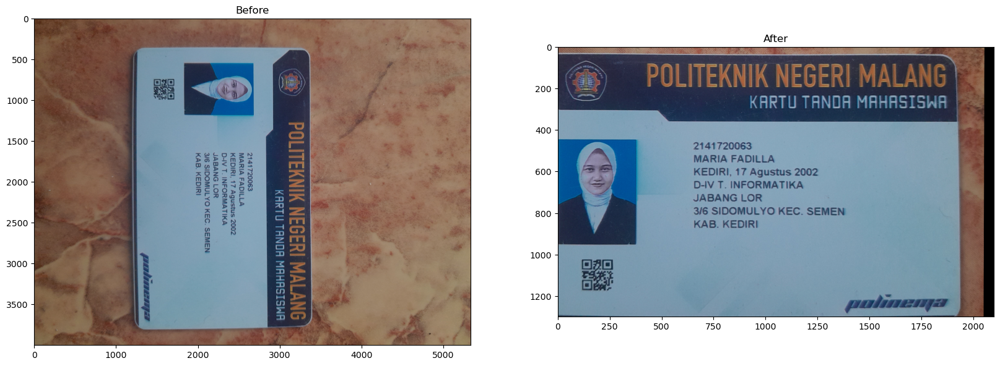

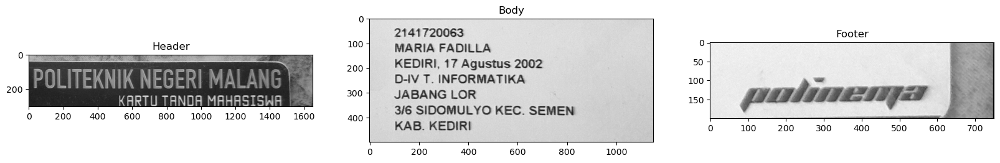

1/1 [==============================] - 0s 21ms/step


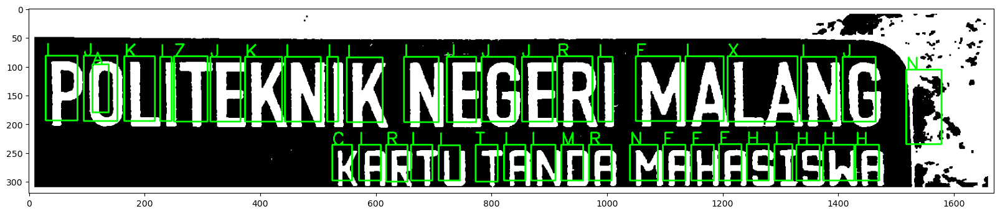

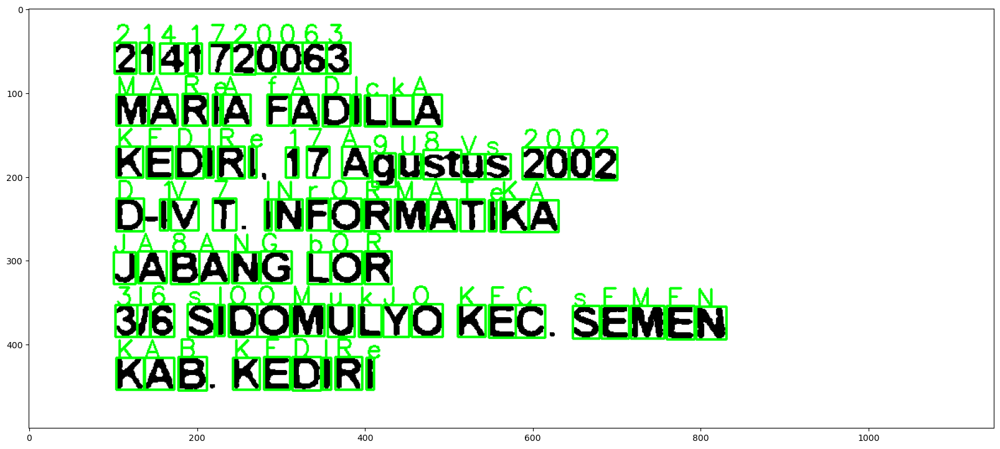

1/1 [==============================] - 0s 21ms/step


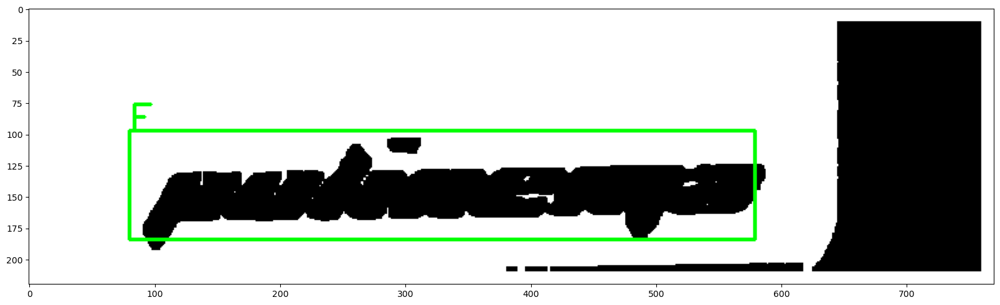

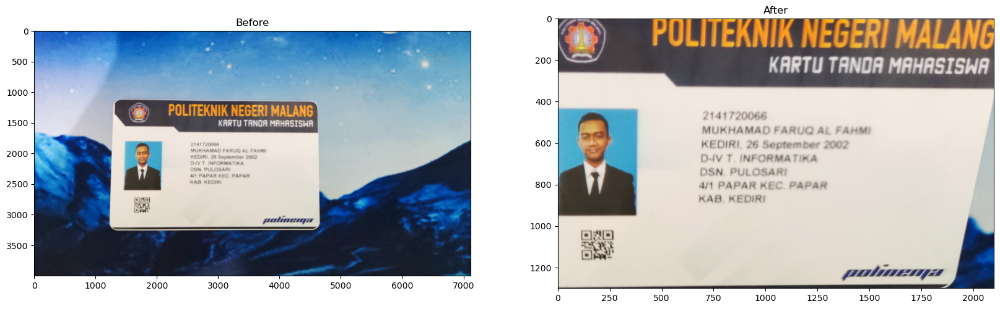

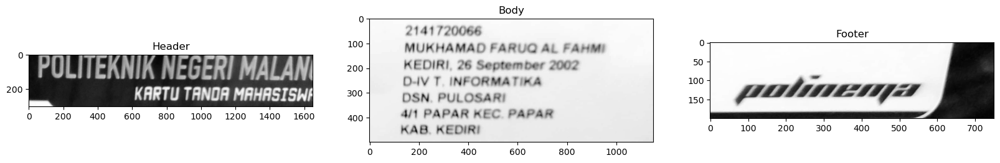

1/1 [==============================] - 0s 22ms/step


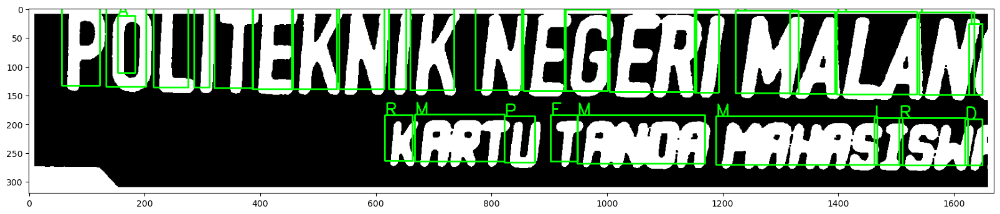

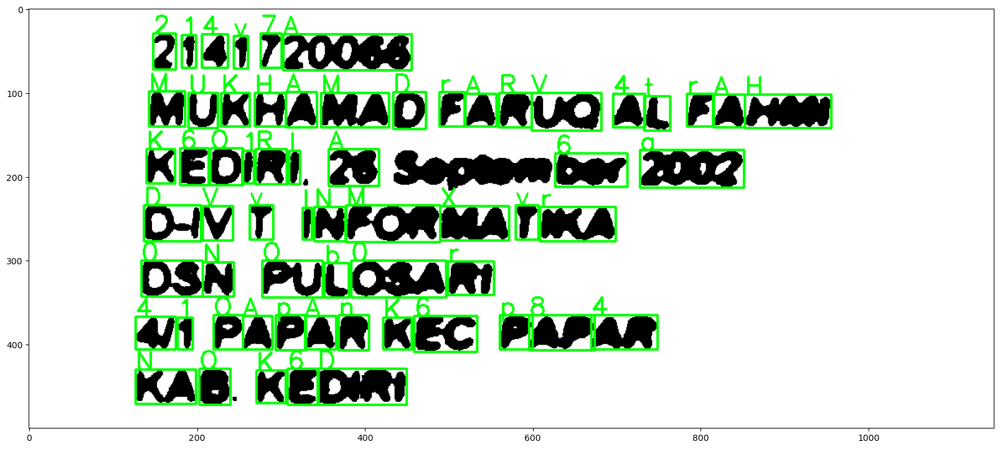

1/1 [==============================] - 0s 22ms/step


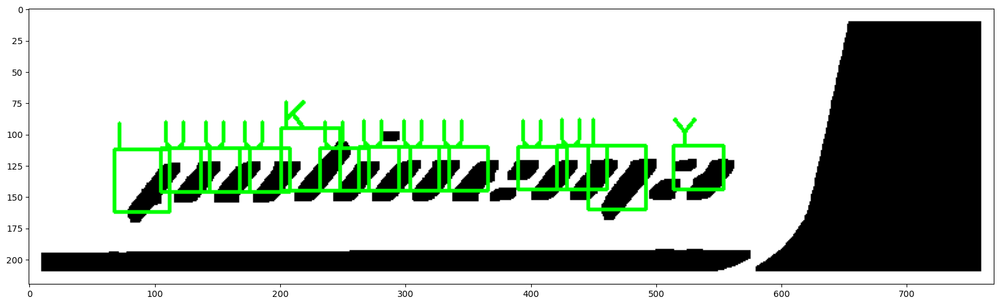

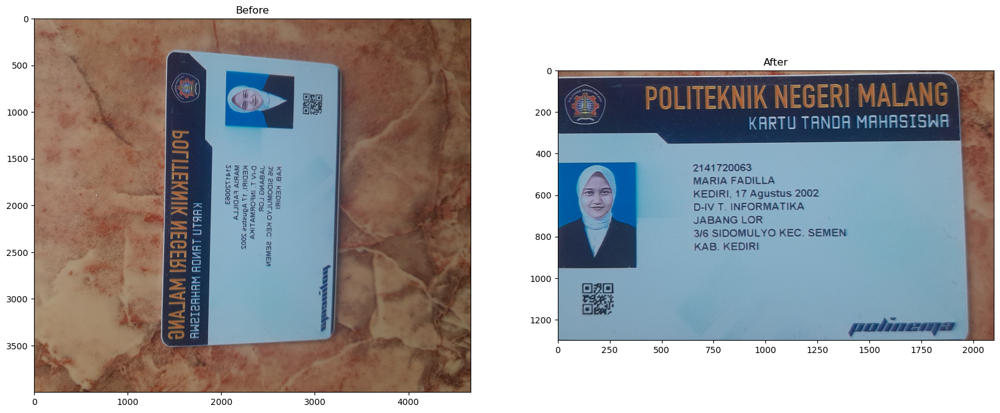

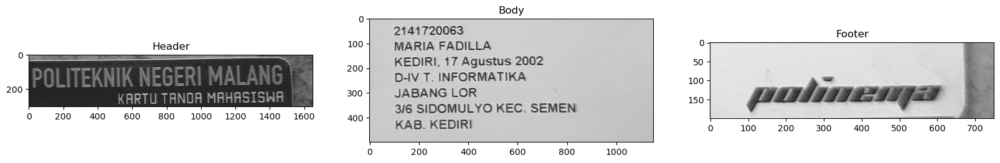

1/1 [==============================] - 0s 21ms/step


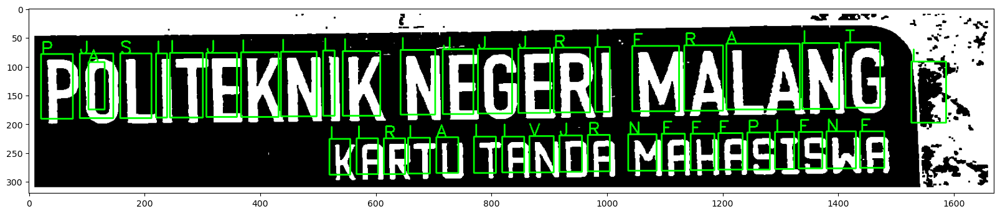

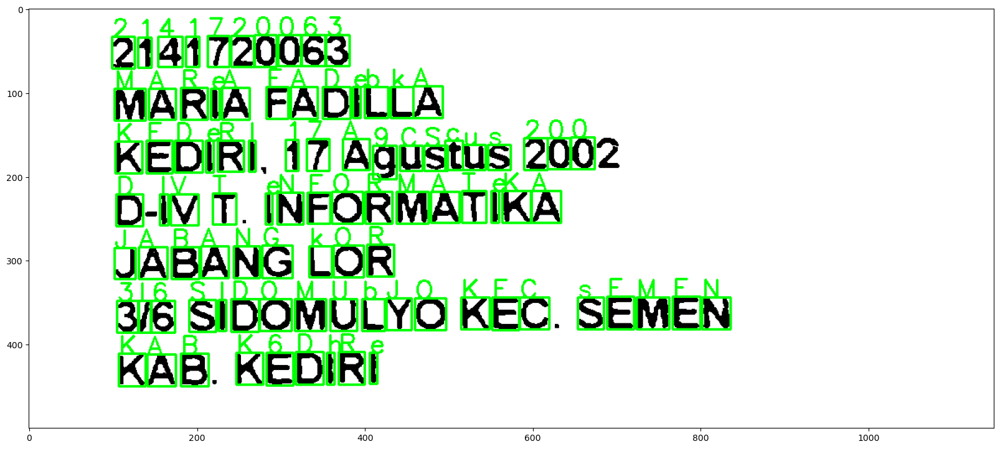

1/1 [==============================] - 0s 21ms/step


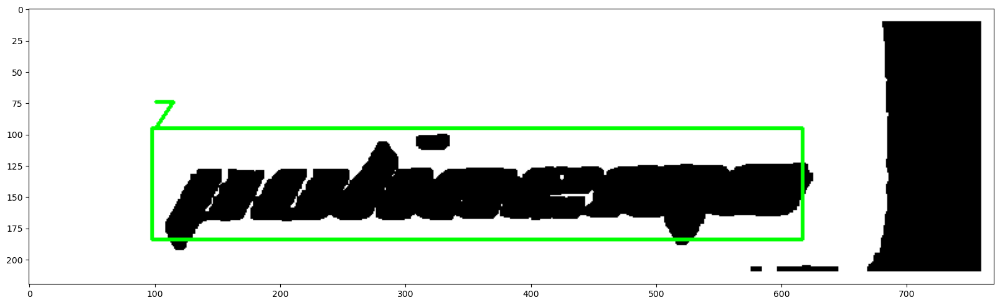

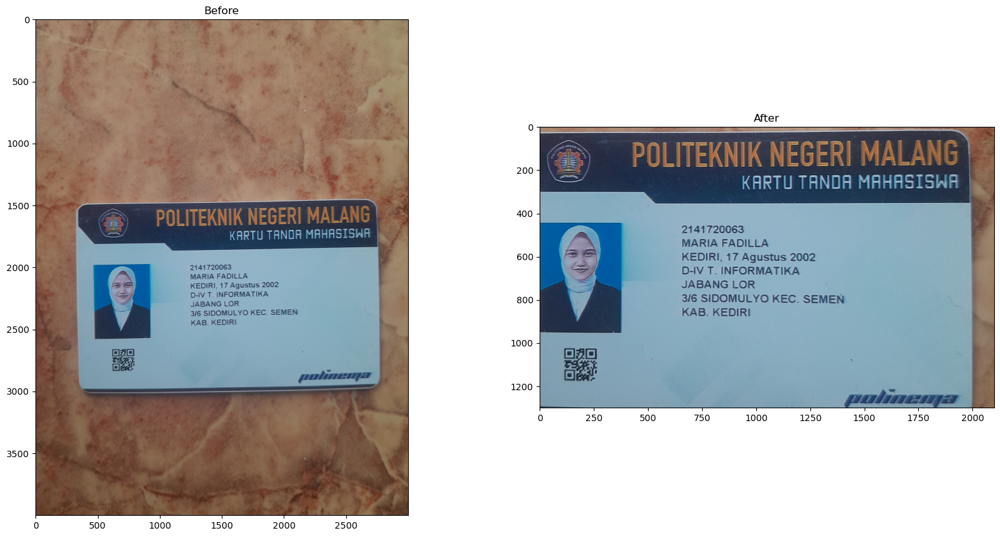

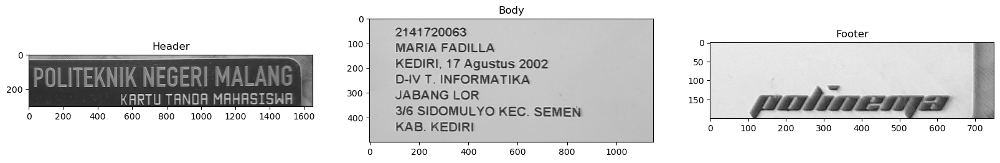

1/1 [==============================] - 0s 28ms/step


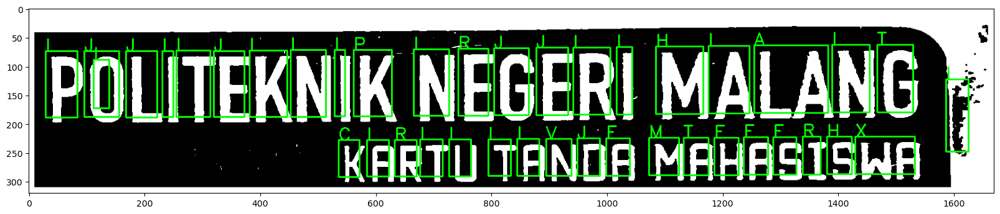

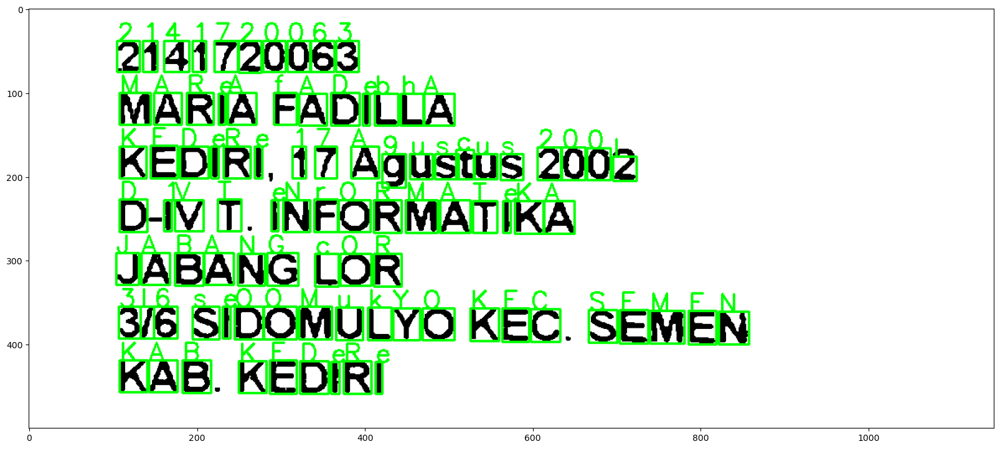

1/1 [==============================] - 0s 48ms/step


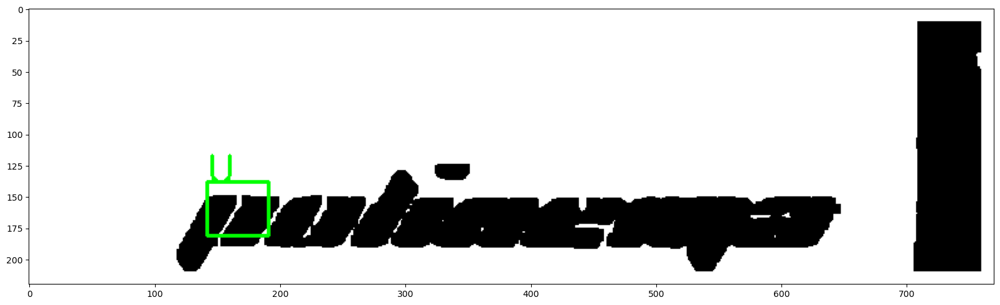

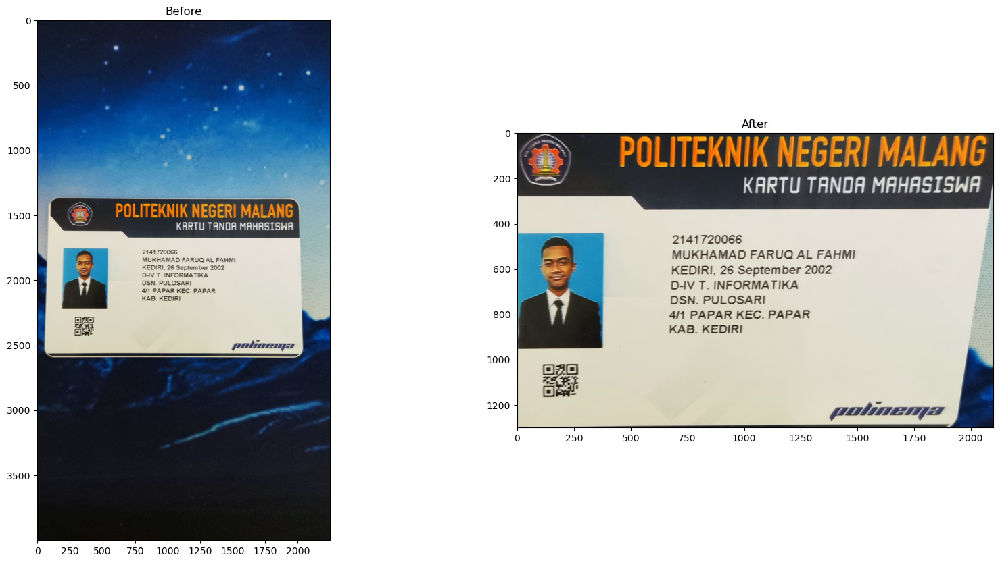

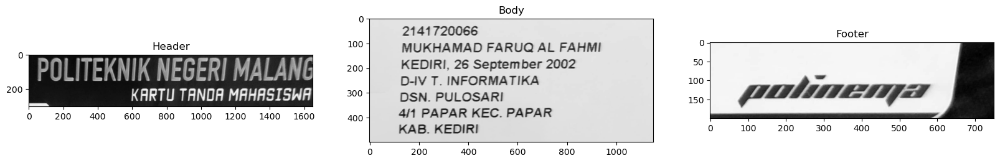

1/1 [==============================] - 0s 21ms/step


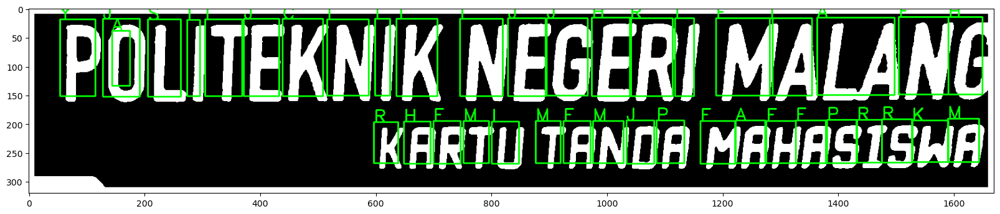

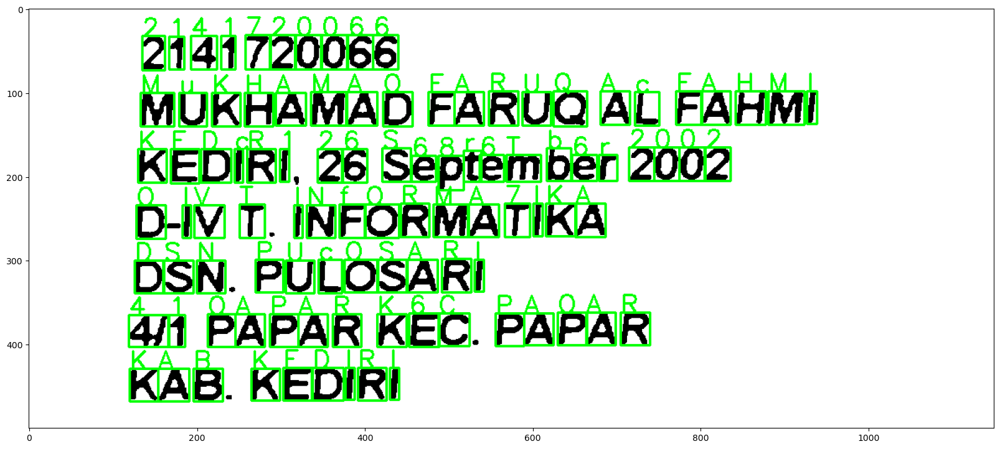

1/1 [==============================] - 0s 22ms/step


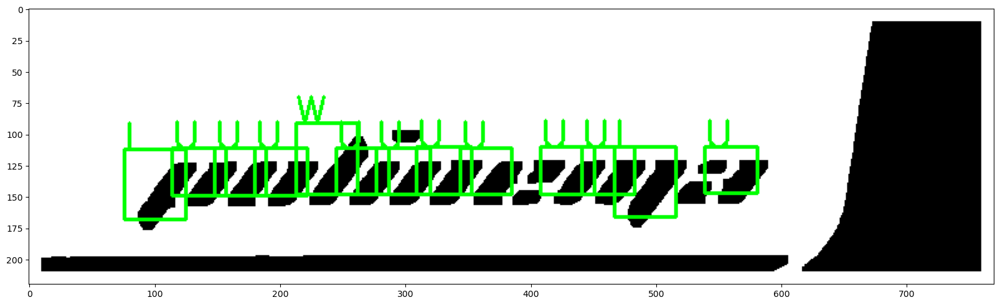

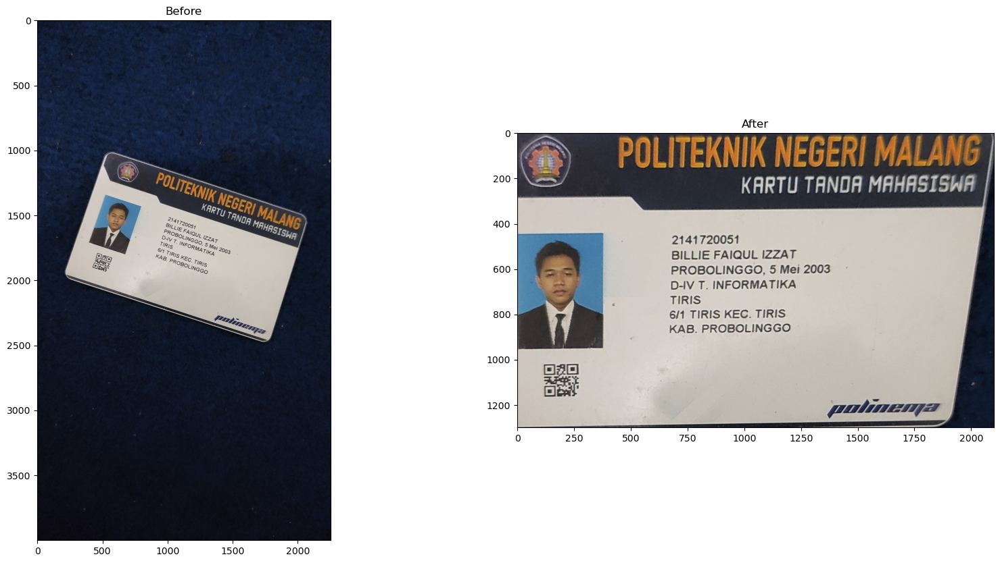

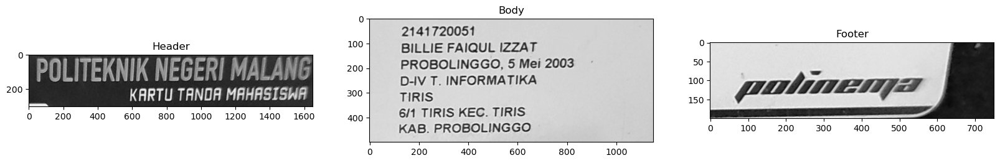

1/1 [==============================] - 0s 23ms/step


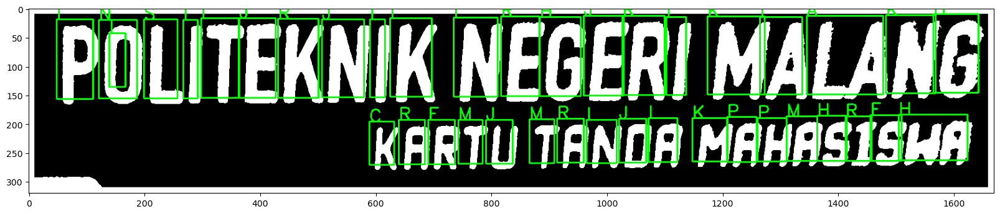

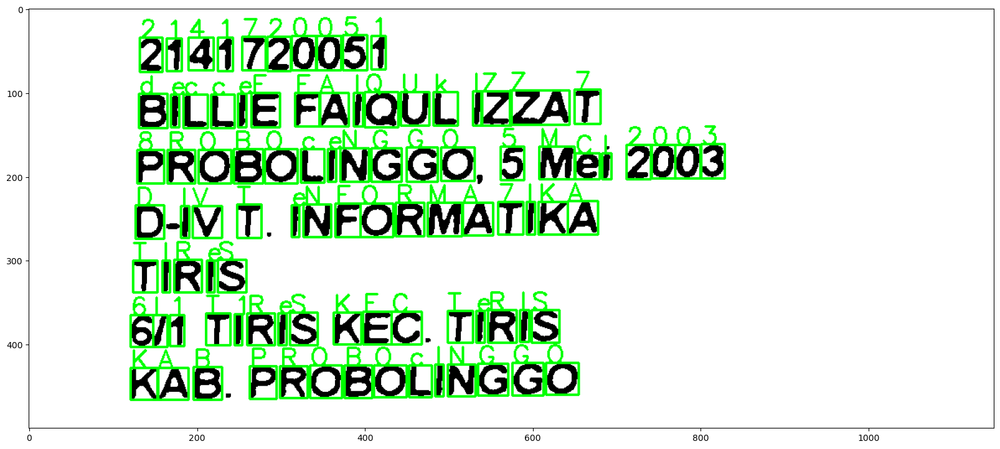

1/1 [==============================] - 0s 22ms/step


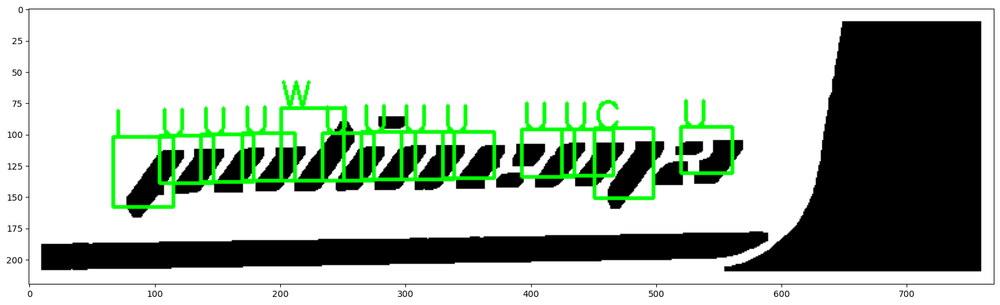

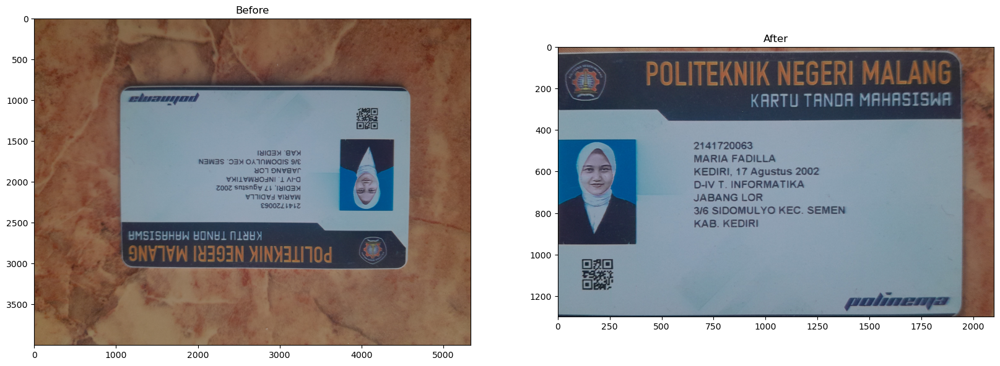

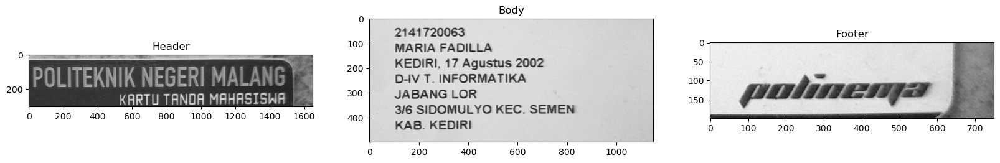

1/1 [==============================] - 0s 22ms/step


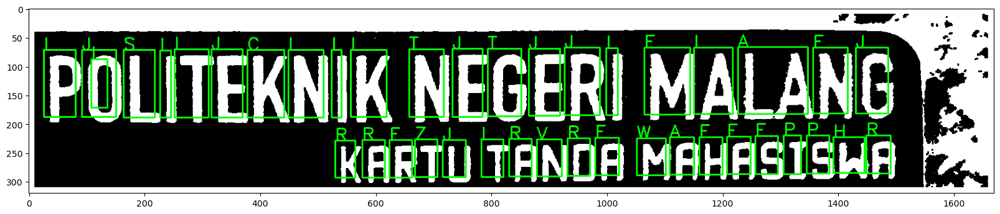

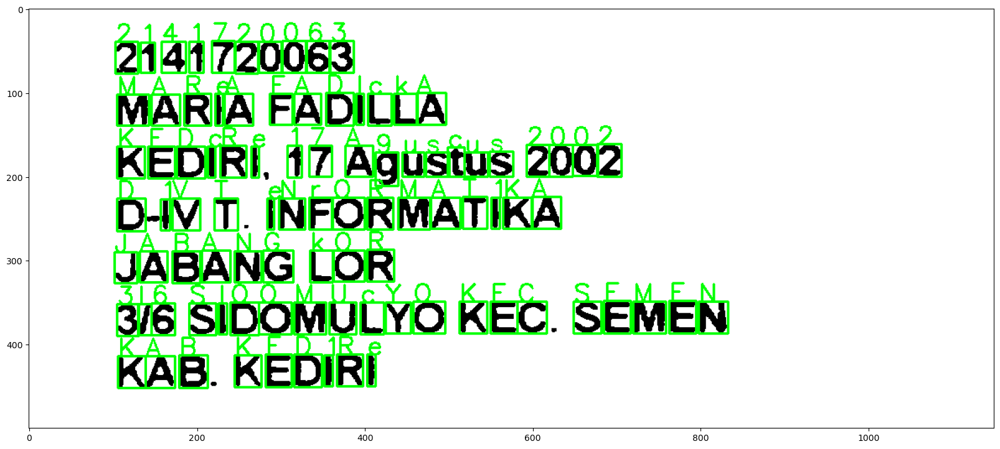

1/1 [==============================] - 0s 22ms/step


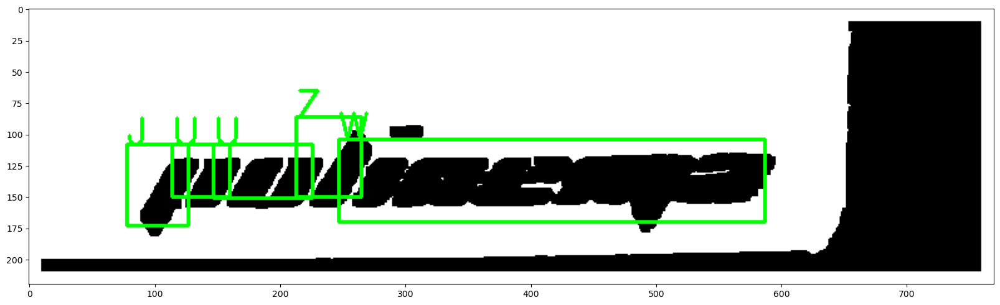

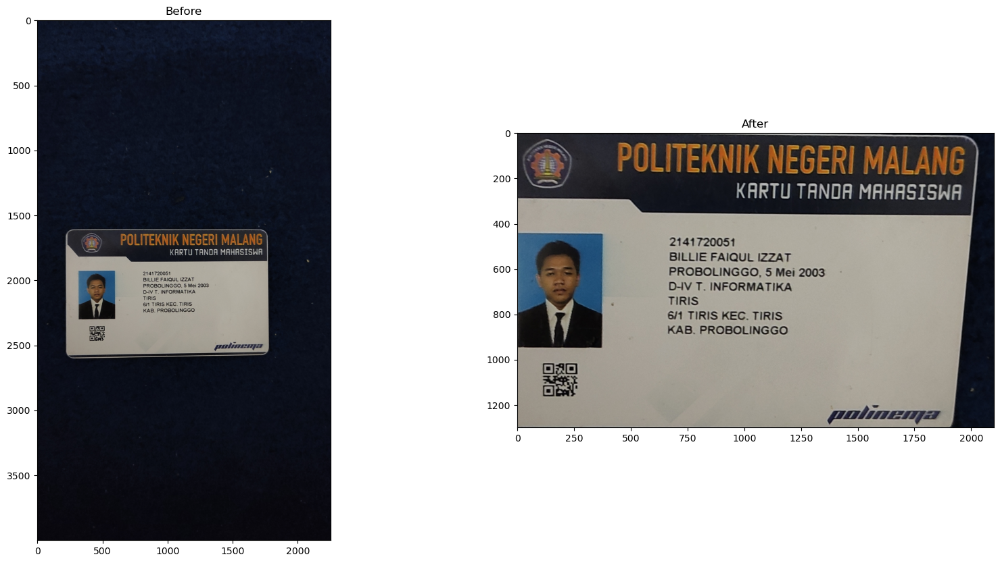

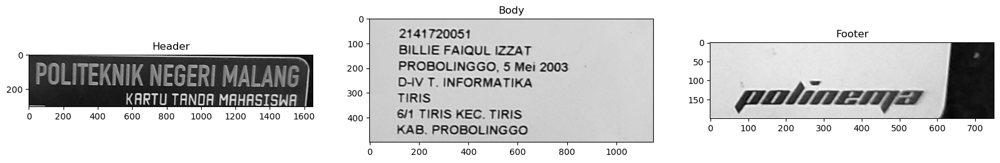

1/1 [==============================] - 0s 21ms/step


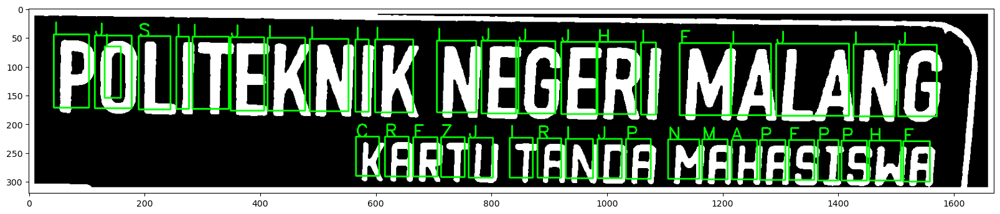

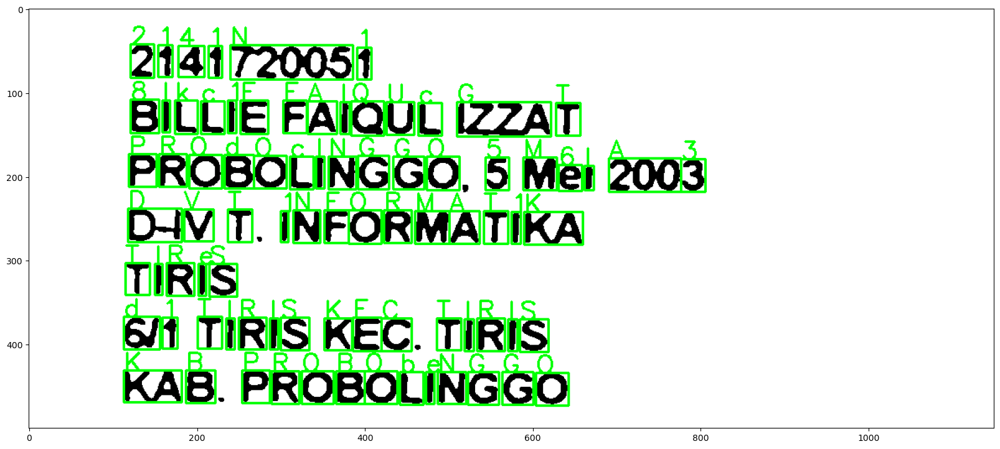

1/1 [==============================] - 0s 22ms/step


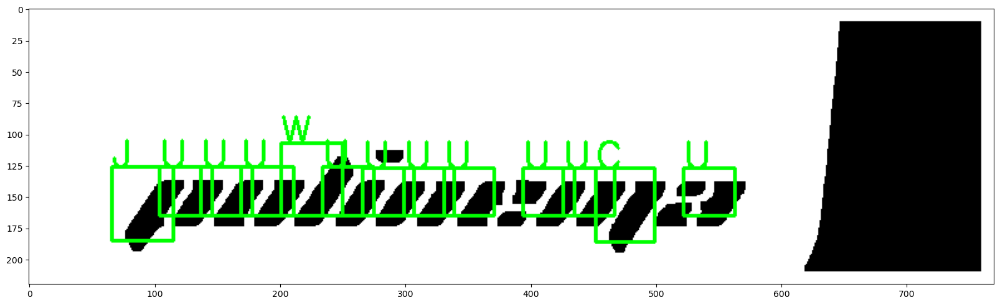

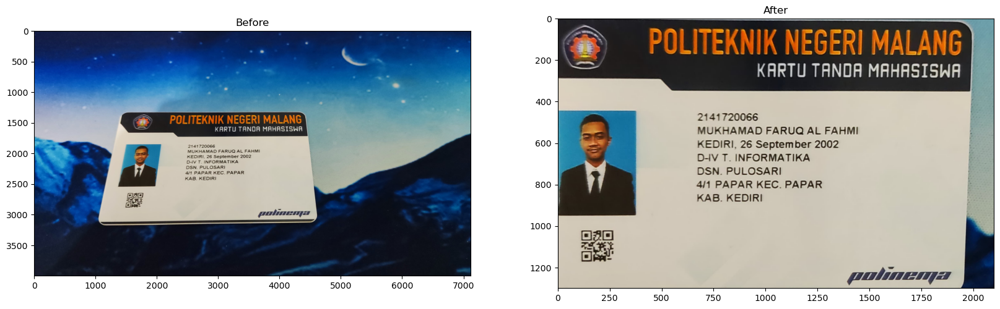

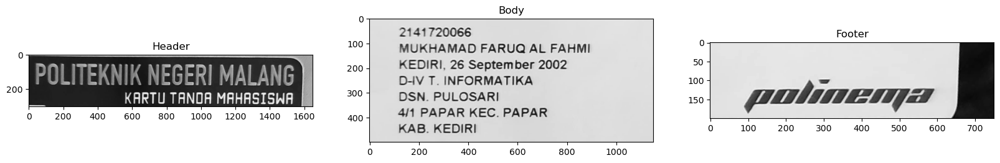

1/1 [==============================] - 0s 24ms/step


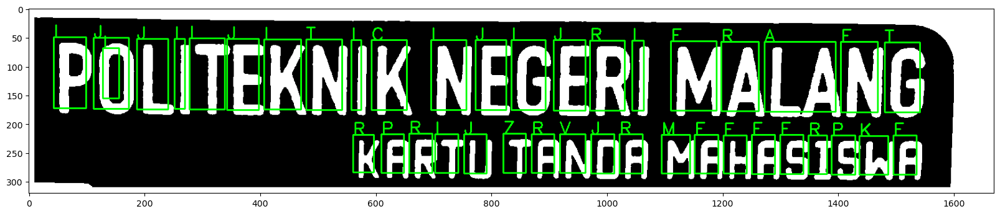

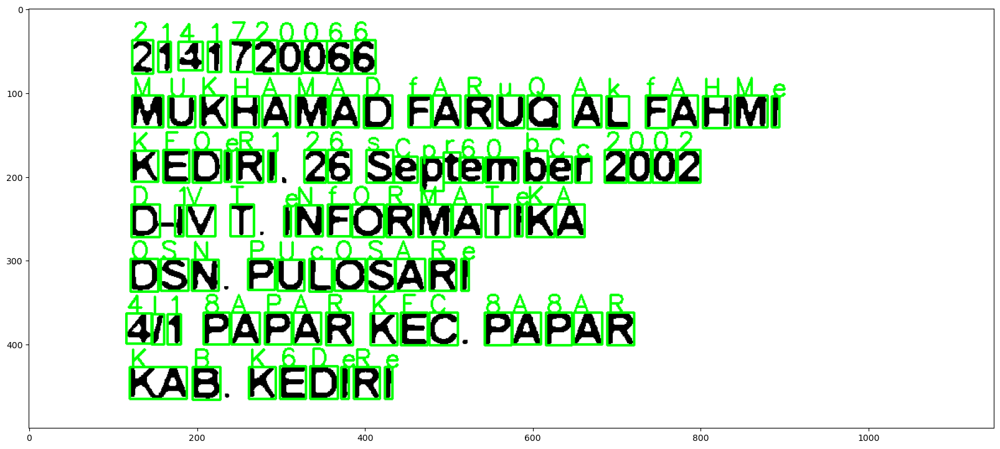

1/1 [==============================] - 0s 21ms/step


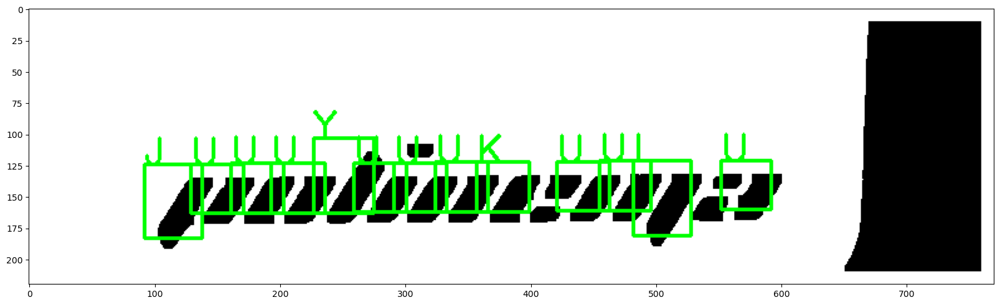

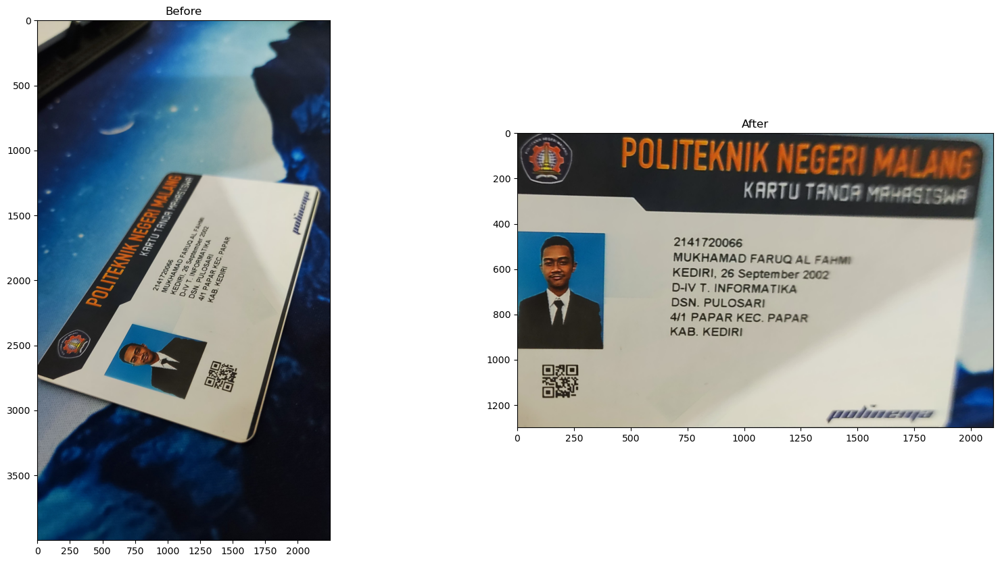

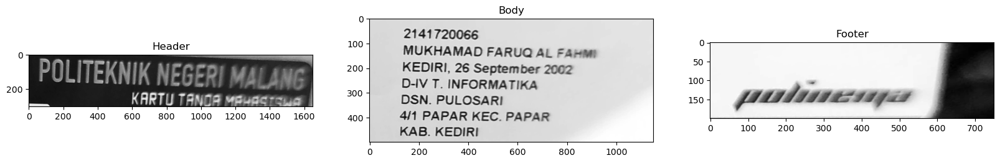

1/1 [==============================] - 0s 22ms/step


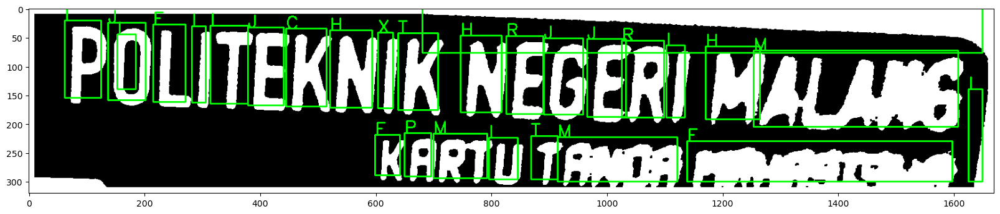

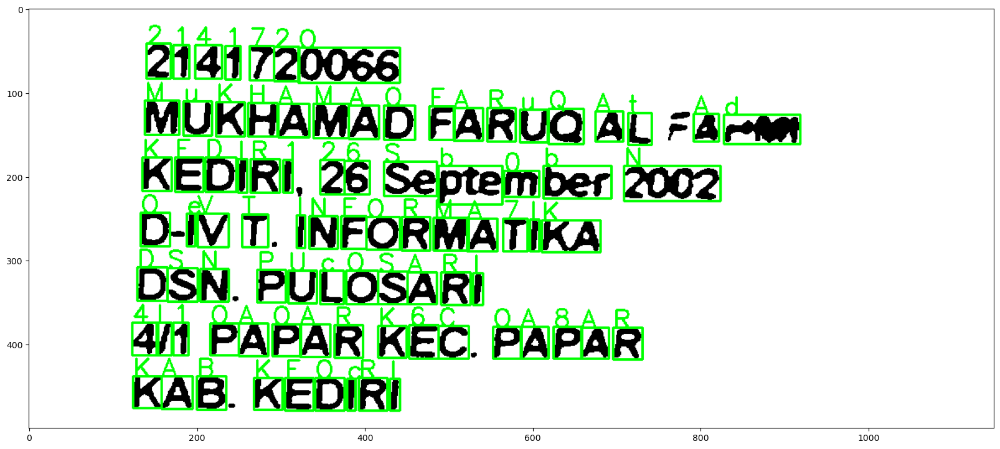

1/1 [==============================] - 0s 24ms/step


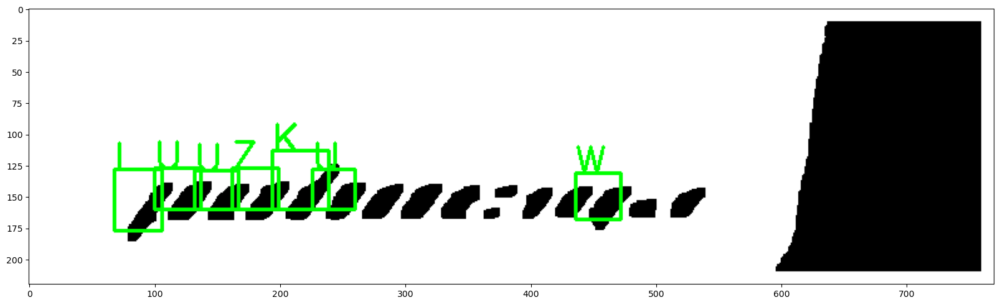

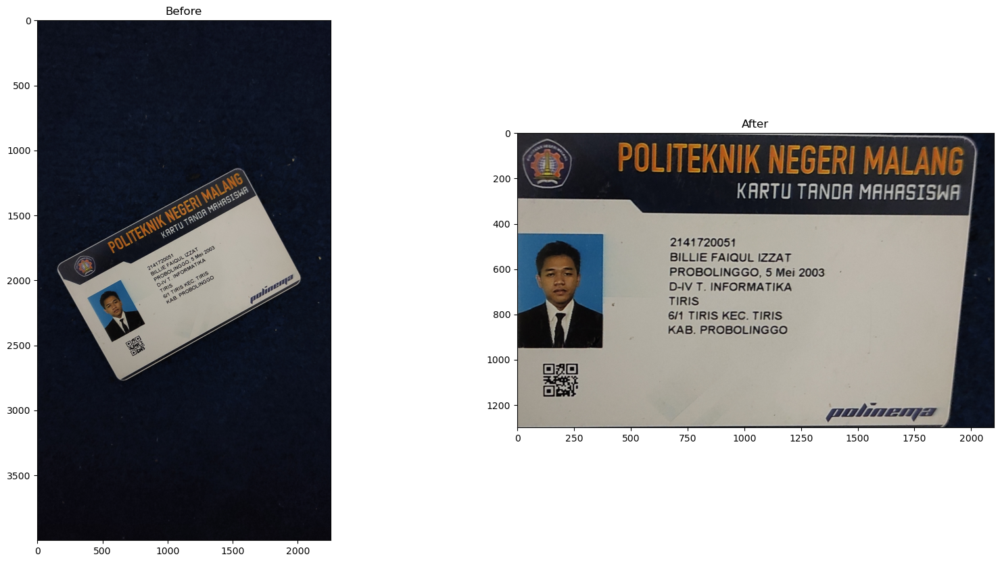

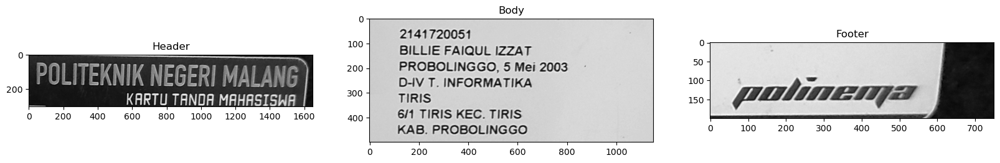

1/1 [==============================] - 0s 21ms/step


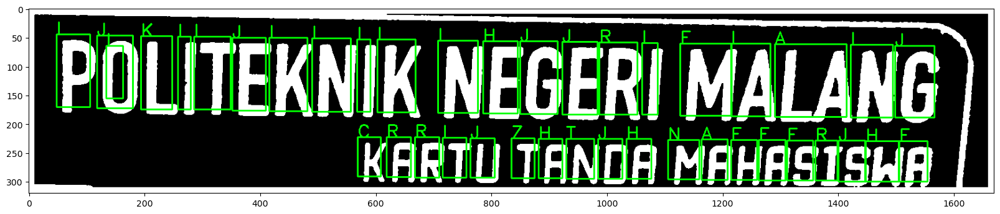

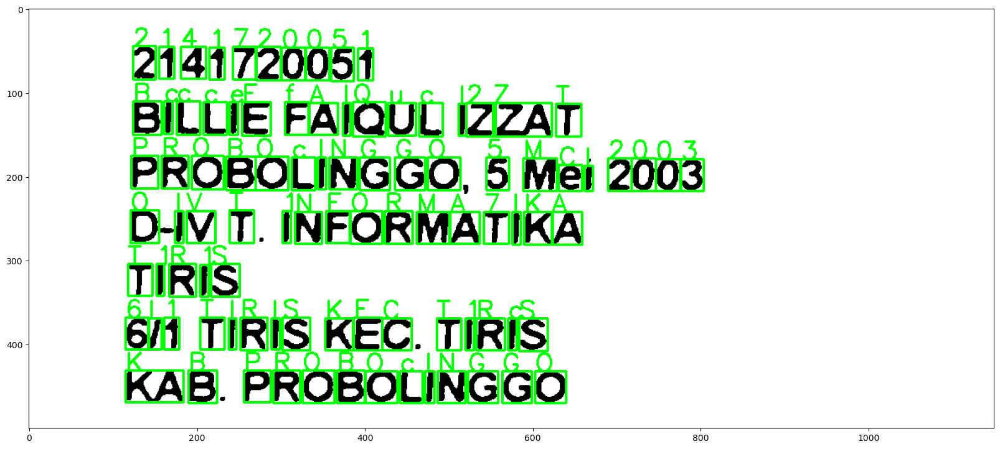

1/1 [==============================] - 0s 21ms/step


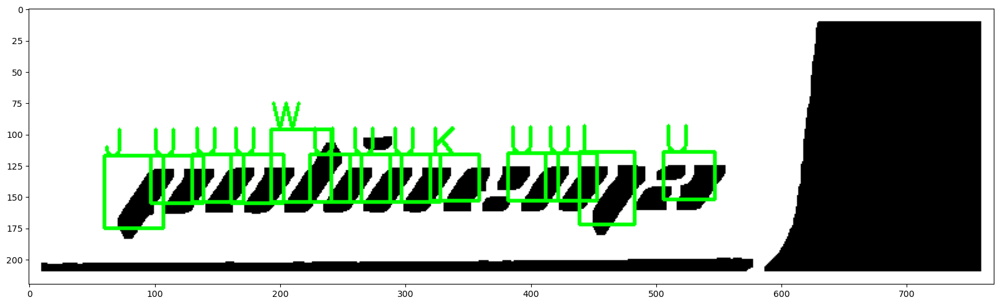

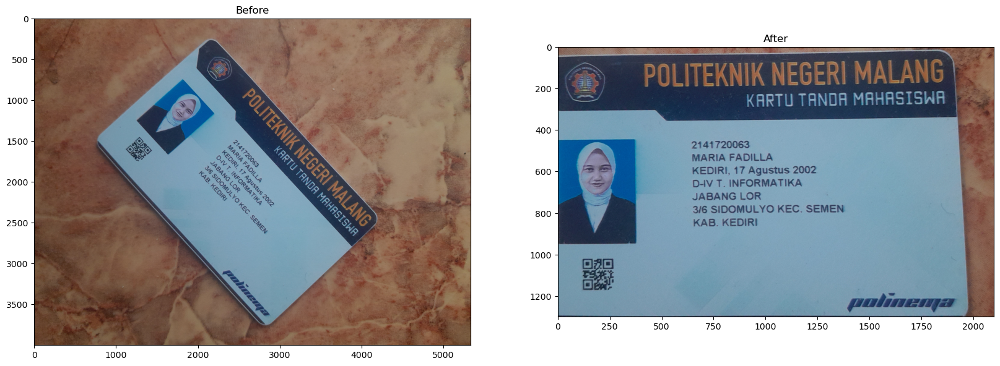

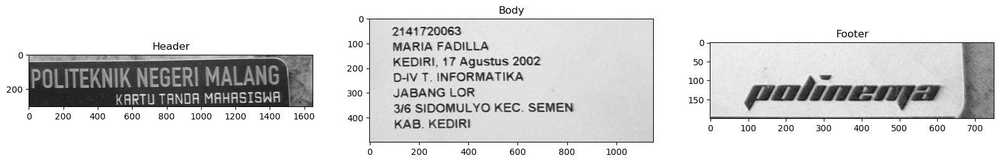

1/1 [==============================] - 0s 21ms/step


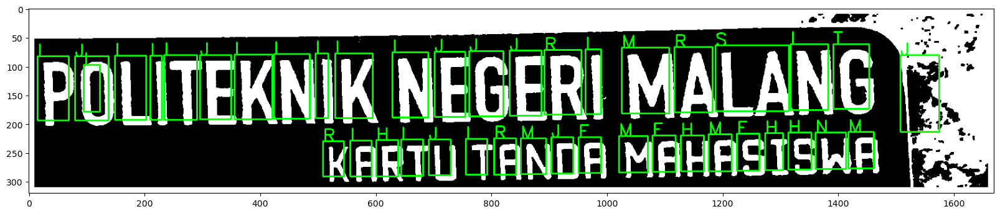

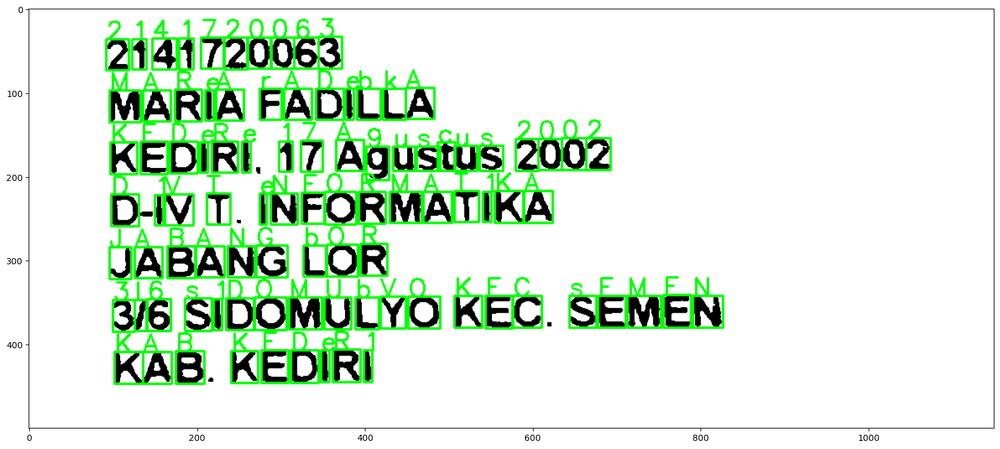

1/1 [==============================] - 0s 21ms/step


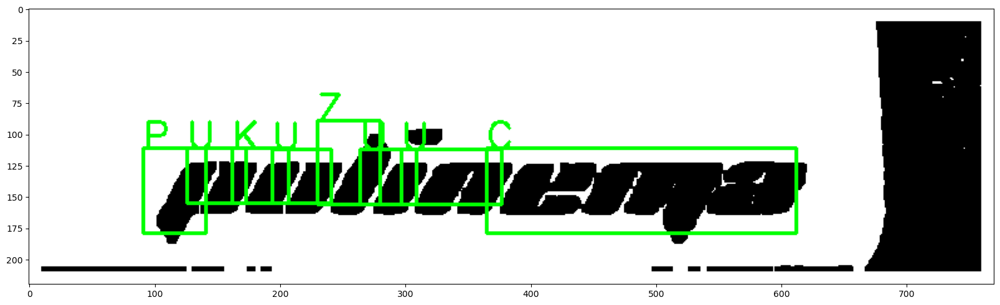

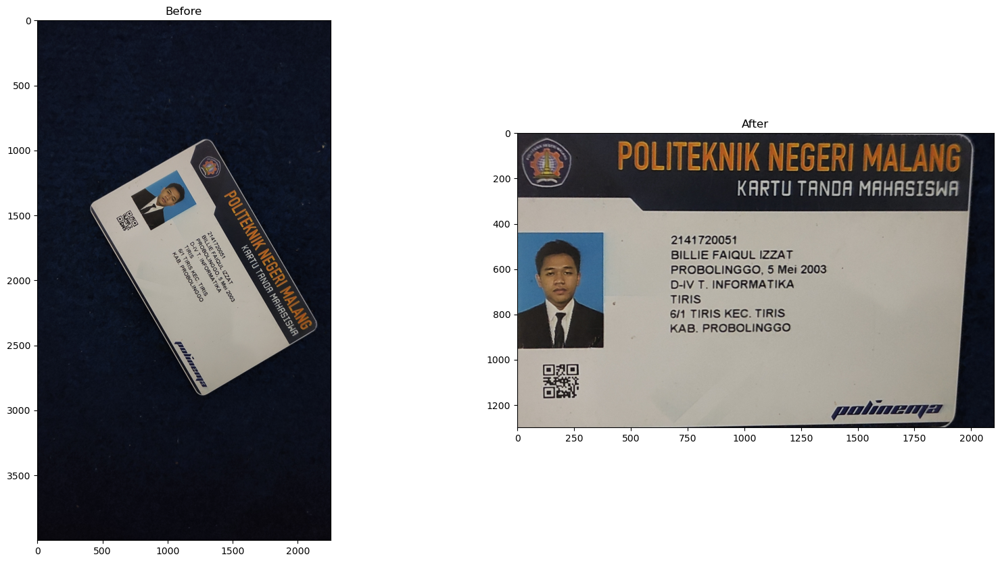

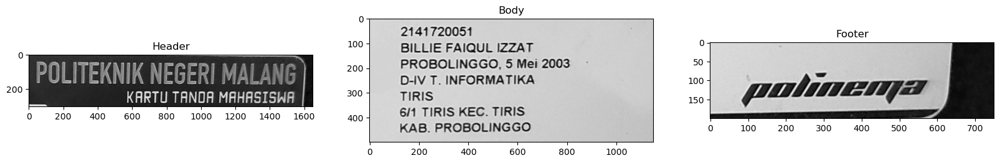

1/1 [==============================] - 0s 22ms/step


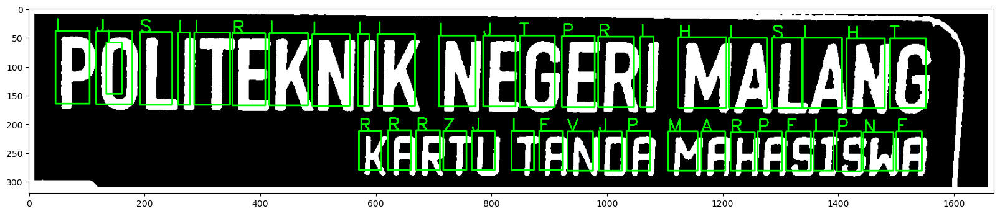

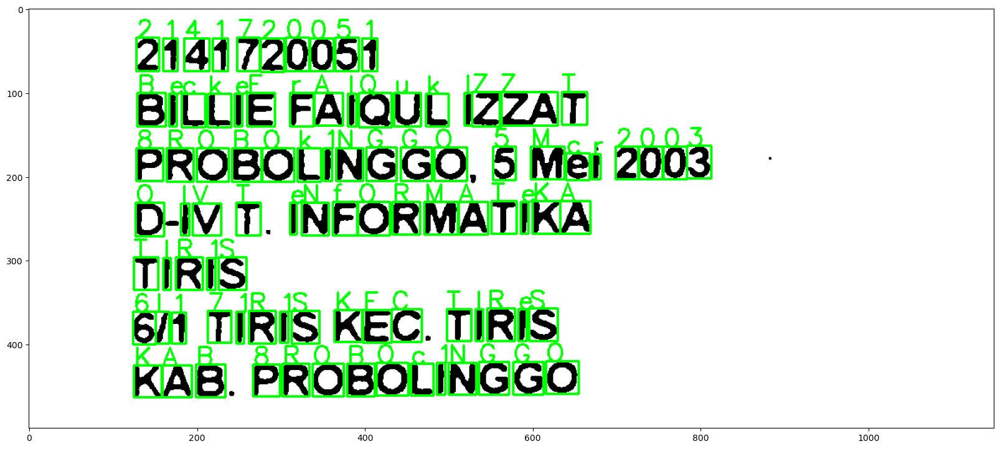

1/1 [==============================] - 0s 21ms/step


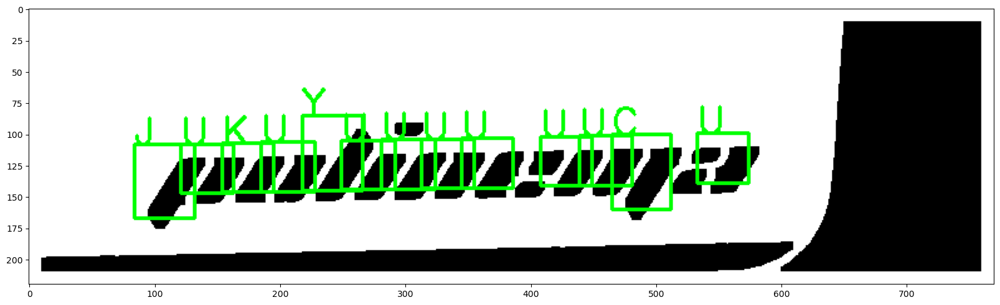

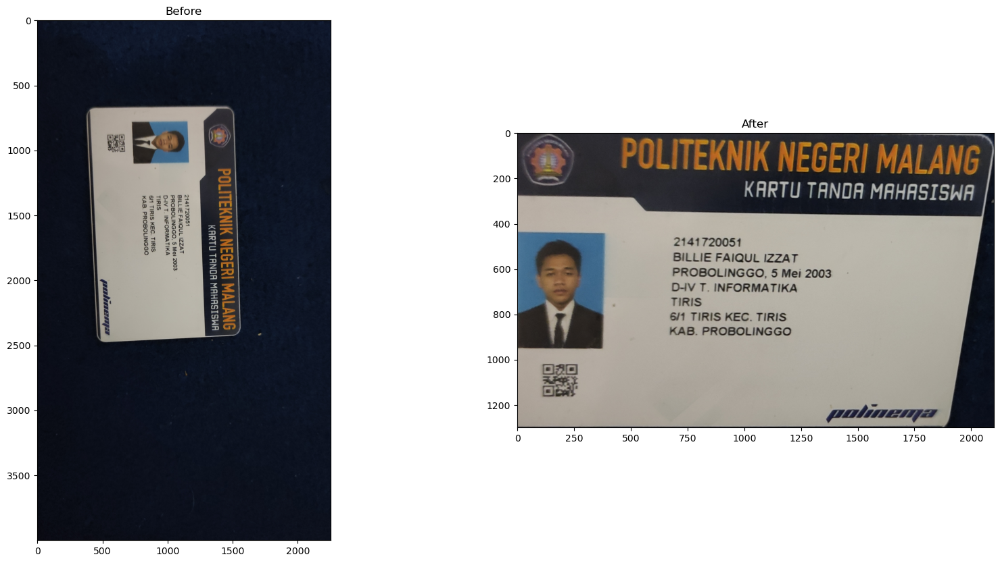

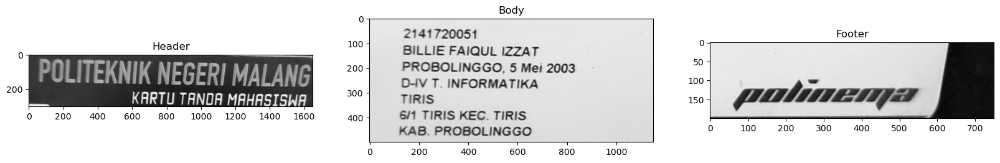

1/1 [==============================] - 0s 21ms/step


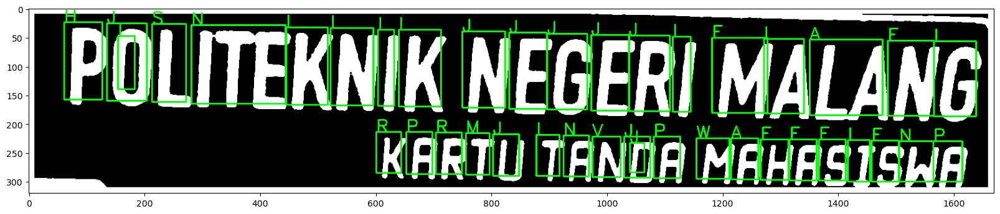

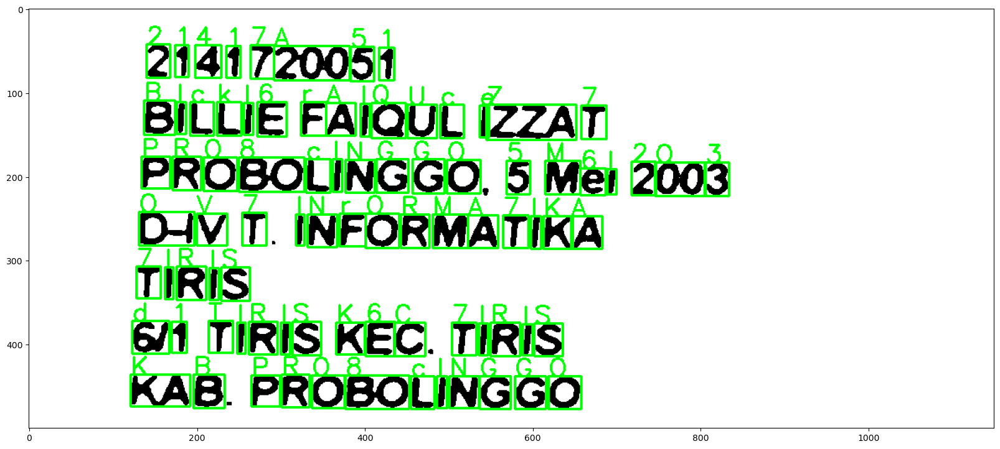

1/1 [==============================] - 0s 21ms/step


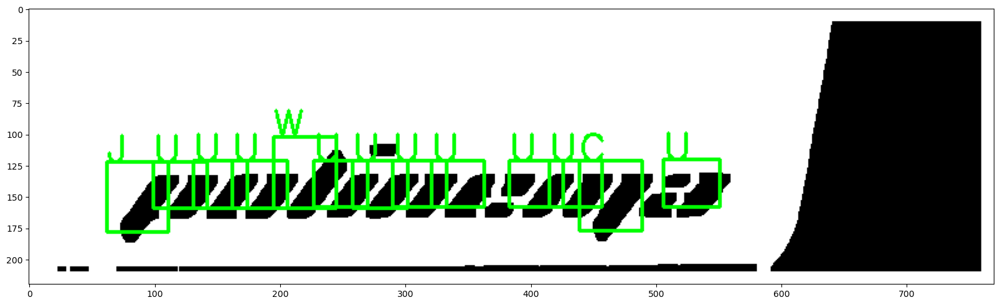

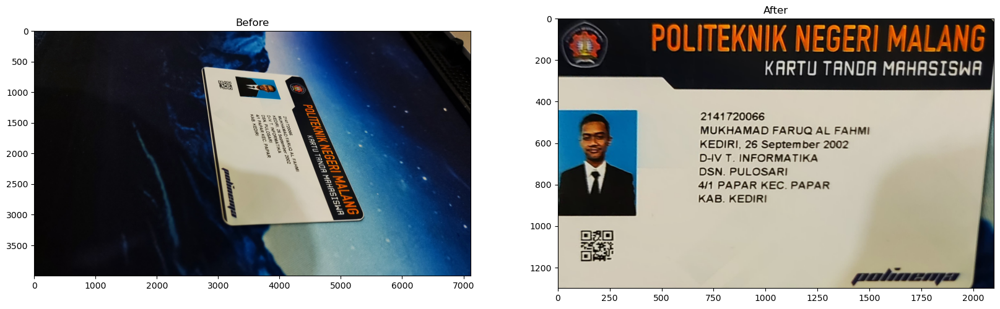

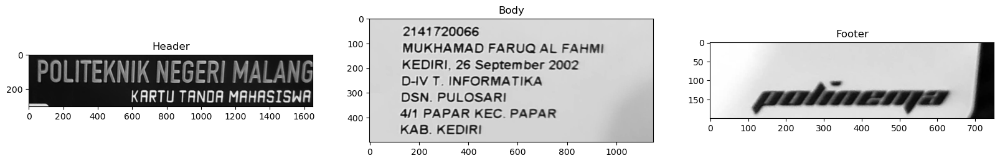

1/1 [==============================] - 0s 21ms/step


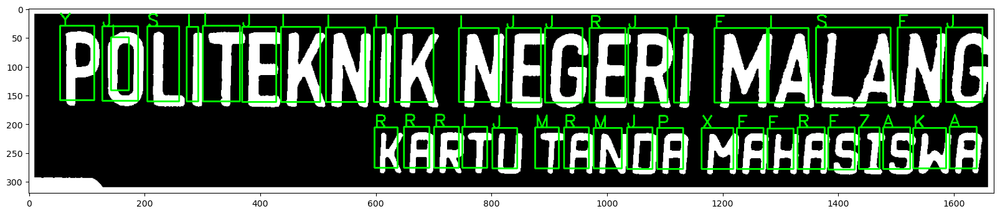

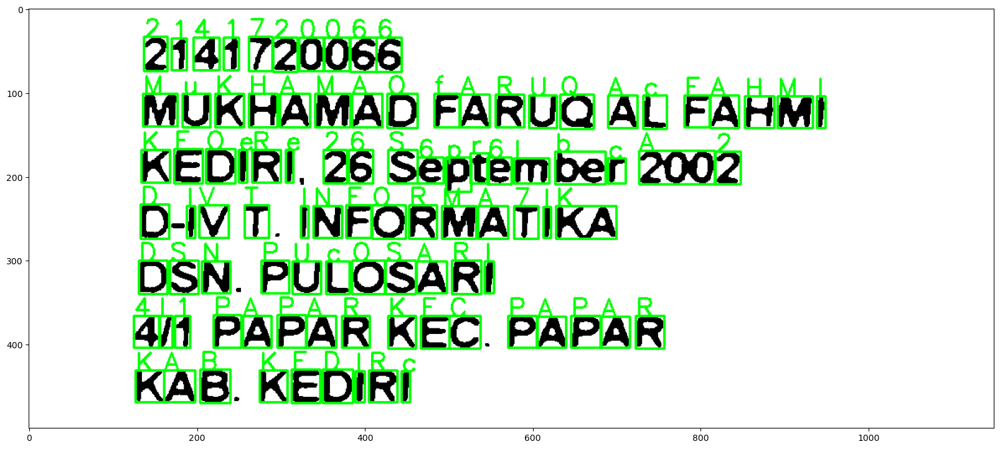

1/1 [==============================] - 0s 21ms/step


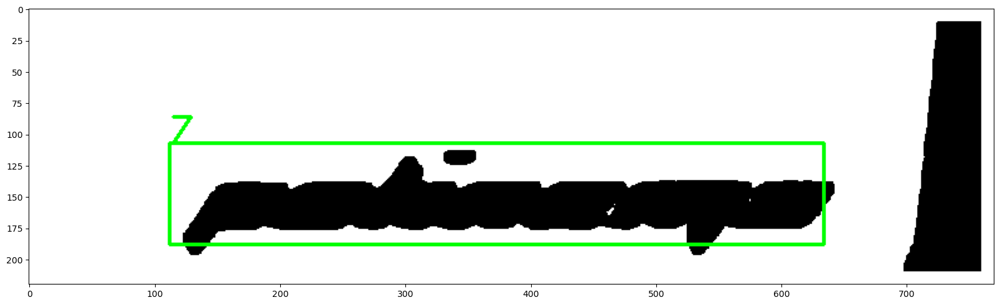

In [8]:
for i in range(15):
    img = ktms[i]
    header, body, footer = find_roi(img, params[i][0], params[i][1])
    if header is not None:
        get_chars_header(header)
    if body is not None:
        get_chars_body(body)
    if footer is not None:
        get_chars_footer(footer)